# Spotify Artist and Track Exploratory Data Analysis

In [1]:
#Import modules
import pandas as pd
import plotly.express as px
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

In [2]:
#Read in artist and track data
artistsFile = 'artists.csv'
artists = pd.read_csv(artistsFile)

tracksFile = 'tracks.csv'
tracks = pd.read_csv(tracksFile)

In [3]:
#Artists and tracks data both have popularity variable so rename the columns to be distinct
artists.rename(columns={'popularity':'popularity_artists'},inplace=True)
tracks.rename(columns={'popularity':'popularity_tracks'},inplace=True)

#### Quick peek at artist and track data

In [4]:
#Subset of artists columns
artists

,id,followers,genres,name,popularity_artists
0,0DheY5irMjBUeLybbCUEZ2,0.0,[],Armid & Amir Zare Pashai feat. Sara Rouzbehani,0
1,0DlhY15l3wsrnlfGio2bjU,5.0,[],ปูนา ภาวิณี,0
2,0DmRESX2JknGPQyO15yxg7,0.0,[],Sadaa,0
3,0DmhnbHjm1qw6NCYPeZNgJ,0.0,[],Tra'gruda,0
4,0Dn11fWM7vHQ3rinvWEl4E,2.0,[],Ioannis Panoutsopoulos,0
...,...,...,...,...,...
1104344,6rJIG42vcWAf1UBdRFlQxB,3345.0,[],Cody Longo,8
1104345,1ljurfXKPlGncNdW3J8zJ8,2123.0,['deep acoustic pop'],Right the Stars,18
1104346,2vnT9YhKIvjVo9LnVjWmr2,26.0,[],Jesse Giddings,0
1104347,3ID0E5XCvnJIYZEq043ZoB,406.0,[],The Boy Band Project,0


In [5]:
#Concise look at artist dataset
artists.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1104349 entries, 0 to 1104348
Data columns (total 5 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   id                  1104349 non-null  object 
 1   followers           1104336 non-null  float64
 2   genres              1104349 non-null  object 
 3   name                1104349 non-null  object 
 4   popularity_artists  1104349 non-null  int64  
dtypes: float64(1), int64(1), object(3)
memory usage: 42.1+ MB


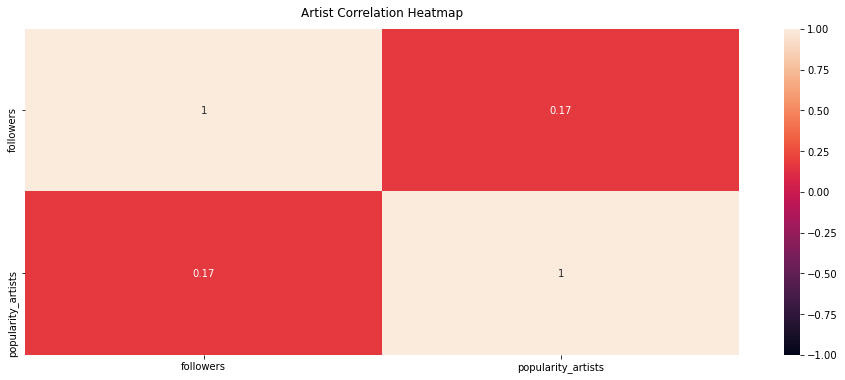

In [6]:
#Correlation matrix for features in artist dataset
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(artists.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Artist Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

#There doesn't appear to be much correlation between number of followers and popularity, which is a bit surprising

In [7]:
#Subset of tracks columns
tracks

,id,name,popularity_tracks,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,35iwgR4jXetI318WEWsa1Q,Carve,6,126903,0,['Uli'],['45tIt06XoI0Iio4LBEVpls'],1922-02-22,0.645,0.4450,0,-13.338,1,0.4510,0.674,0.744000,0.1510,0.1270,104.851,3
1,021ht4sdgPcrDgSk7JTbKY,Capítulo 2.16 - Banquero Anarquista,0,98200,0,['Fernando Pessoa'],['14jtPCOoNZwquk5wd9DxrY'],1922-06-01,0.695,0.2630,0,-22.136,1,0.9570,0.797,0.000000,0.1480,0.6550,102.009,1
2,07A5yehtSnoedViJAZkNnc,Vivo para Quererte - Remasterizado,0,181640,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.434,0.1770,1,-21.180,1,0.0512,0.994,0.021800,0.2120,0.4570,130.418,5
3,08FmqUhxtyLTn6pAh6bk45,El Prisionero - Remasterizado,0,176907,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.321,0.0946,7,-27.961,1,0.0504,0.995,0.918000,0.1040,0.3970,169.980,3
4,08y9GfoqCWfOGsKdwojr5e,Lady of the Evening,0,163080,0,['Dick Haymes'],['3BiJGZsyX9sJchTqcSA7Su'],1922,0.402,0.1580,3,-16.900,0,0.0390,0.989,0.130000,0.3110,0.1960,103.220,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586667,5rgu12WBIHQtvej2MdHSH0,云与海,50,258267,0,['阿YueYue'],['1QLBXKM5GCpyQQSVMNZqrZ'],2020-09-26,0.560,0.5180,0,-7.471,0,0.0292,0.785,0.000000,0.0648,0.2110,131.896,4
586668,0NuWgxEp51CutD2pJoF4OM,blind,72,153293,0,['ROLE MODEL'],['1dy5WNgIKQU6ezkpZs4y8z'],2020-10-21,0.765,0.6630,0,-5.223,1,0.0652,0.141,0.000297,0.0924,0.6860,150.091,4
586669,27Y1N4Q4U3EfDU5Ubw8ws2,What They'll Say About Us,70,187601,0,['FINNEAS'],['37M5pPGs6V1fchFJSgCguX'],2020-09-02,0.535,0.3140,7,-12.823,0,0.0408,0.895,0.000150,0.0874,0.0663,145.095,4
586670,45XJsGpFTyzbzeWK8VzR8S,A Day At A Time,58,142003,0,"['Gentle Bones', 'Clara Benin']","['4jGPdu95icCKVF31CcFKbS', '5ebPSE9YI5aLeZ1Z2g...",2021-03-05,0.696,0.6150,10,-6.212,1,0.0345,0.206,0.000003,0.3050,0.4380,90.029,4


In [8]:
#Concise look at tracks data
tracks.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 586672 entries, 0 to 586671
Data columns (total 20 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   id                 586672 non-null  object 
 1   name               586601 non-null  object 
 2   popularity_tracks  586672 non-null  int64  
 3   duration_ms        586672 non-null  int64  
 4   explicit           586672 non-null  int64  
 5   artists            586672 non-null  object 
 6   id_artists         586672 non-null  object 
 7   release_date       586672 non-null  object 
 8   danceability       586672 non-null  float64
 9   energy             586672 non-null  float64
 10  key                586672 non-null  int64  
 11  loudness           586672 non-null  float64
 12  mode               586672 non-null  int64  
 13  speechiness        586672 non-null  float64
 14  acousticness       586672 non-null  float64
 15  instrumentalness   586672 non-null  float64
 16  li

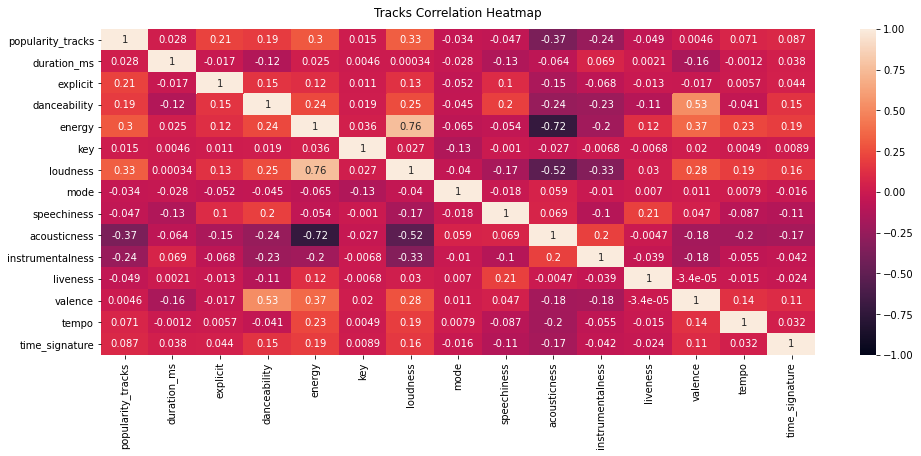

In [9]:
#Correlation matrix for features in tracks dataset
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(tracks.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Tracks Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

#### Tracks Dataset Plots

In [10]:
#Reformat some tracks columns for plotting
tracks['release_date'] = pd.to_datetime(tracks['release_date'])
tracks['release_year'] = tracks['release_date'].dt.year

In [11]:
#Calculate annual average of features in tracks table
tracksAnnAvg = tracks.groupby('release_year').mean()
tracksAnnAvg.reset_index(inplace=True)

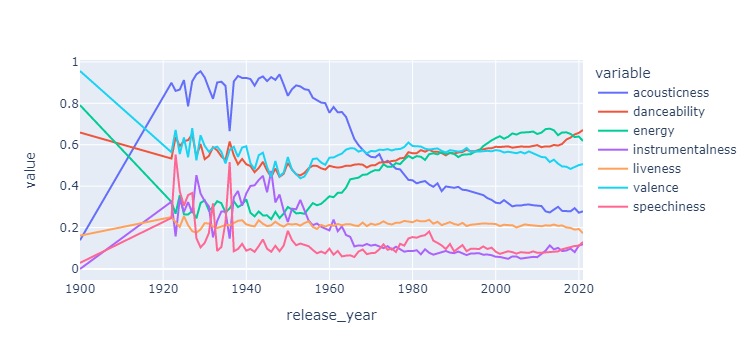

In [12]:
#Plot selection of tracks features by year to see general trends
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence','speechiness']
fig = px.line(tracksAnnAvg, x='release_year', y=sound_features)
fig.show()

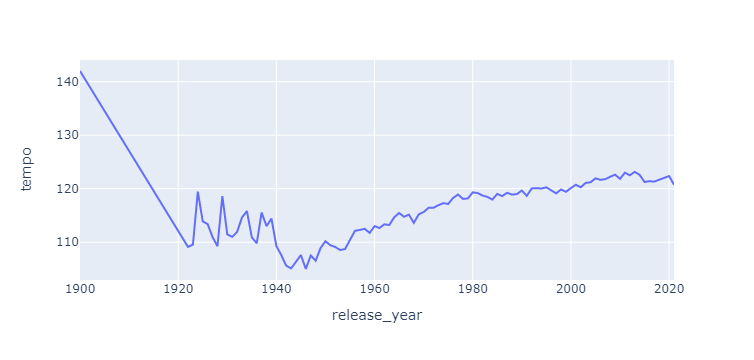

In [13]:
#See how tempo has changed over time
fig = px.line(tracksAnnAvg, x='release_year', y='tempo')
fig.show()

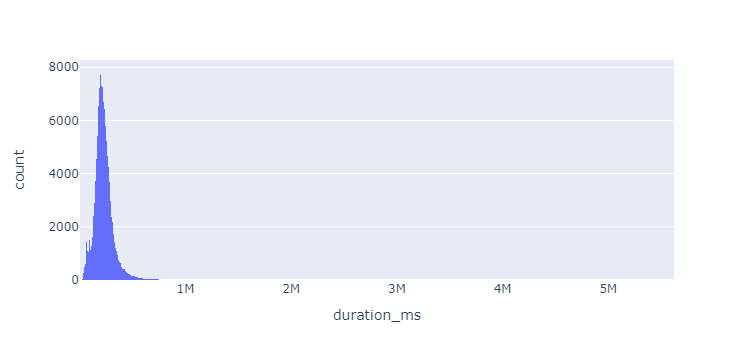

In [14]:
#What is the distribution of song duration (ms) in the tracks tables?
fig = px.histogram(tracks, x='duration_ms')
fig.show()

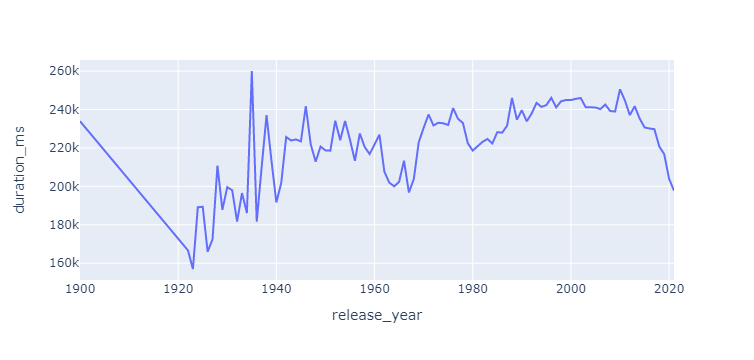

In [15]:
#How has duration changed over time?
fig = px.line(tracksAnnAvg, x='release_year', y='duration_ms')
fig.show()

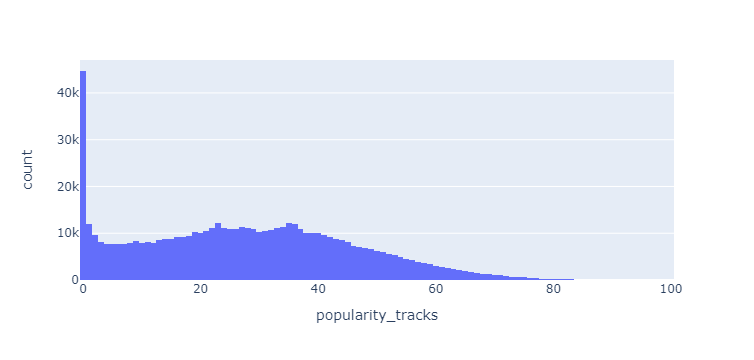

In [16]:
#What is the distribution of popularity in the tracks tables?
fig = px.histogram(tracks, x='popularity_tracks')
fig.show()

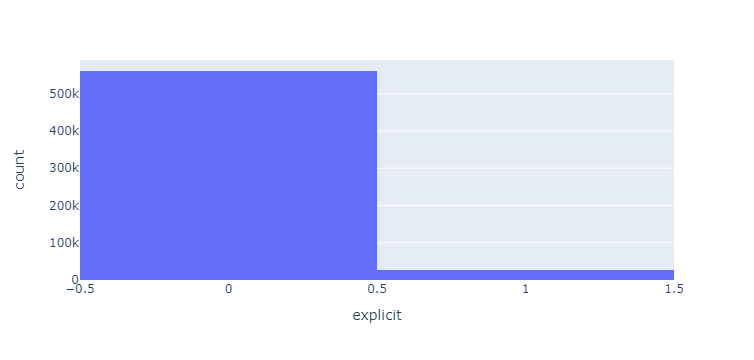

In [17]:
#What is the distribution of explicit (0 or 1) in the tracks tables?
fig = px.histogram(tracks, x='explicit')
fig.show()

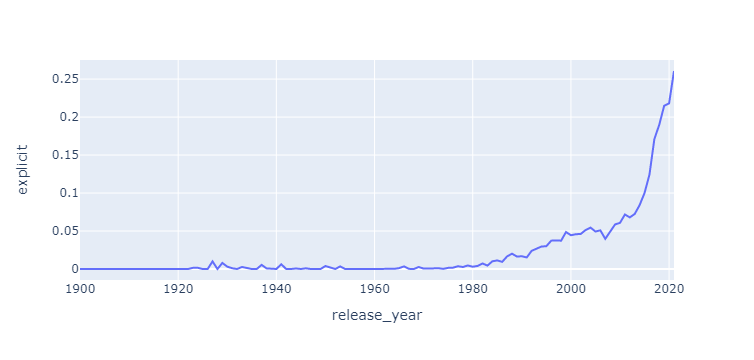

In [18]:
#How have explicit songs changed over time? 
fig = px.line(tracksAnnAvg, x='release_year', y='explicit')
fig.show()

In [19]:
#How many unique artists are in the tracks table?
print("Unique artists = " + str(len(tracks['artists'].unique())))
print("Unique id_artists= " + str(len(tracks['id_artists'].unique())))
print("")
print("Dataset is ~600,000 records so there are many rows that contain tracks from multiple artists (not surprising). Also slight mismatch between artist and id_artists fields")

Unique artists = 114030
Unique id_artists= 115062

Dataset is ~600,000 records so there are many rows that contain tracks from multiple artists (not surprising). Also slight mismatch between artist and id_artists fields


#### Artists Database Plots

In [20]:
#Replace empty genres in artists table with nans
artists.loc[artists.genres=='[]','genres'] = np.nan

In [21]:
#Look at unique artists and names fields to understand the difference between these fields
print("Unique artist ids = " + str(len(artists['id'].unique())))

print("Unique artist names = " + str(len(artists['name'].unique())))

print("")
print("Expected id and name to be completely unique but only id is. Need to look into 'name' more to understand")

Unique artist ids = 1104349
Unique artist names = 1078660

Expected id and name to be completely unique but only id is. Need to look into 'name' more to understand


Unique genres = 48788


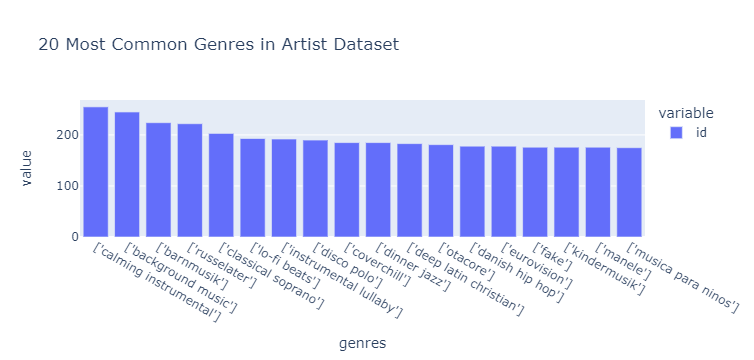

In [22]:
#Look at genres in artists table
print('Unique genres = '+ str(len(artists.genres.unique())))

#Get count by genre and plot 20 most common genres in artist dataset
artistsGenres = artists.groupby('genres').id.count()
n=20
fig = px.bar(artistsGenres.nlargest(n)[1:n-1],title=str(n)+' Most Common Genres in Artist Dataset')
fig.show()

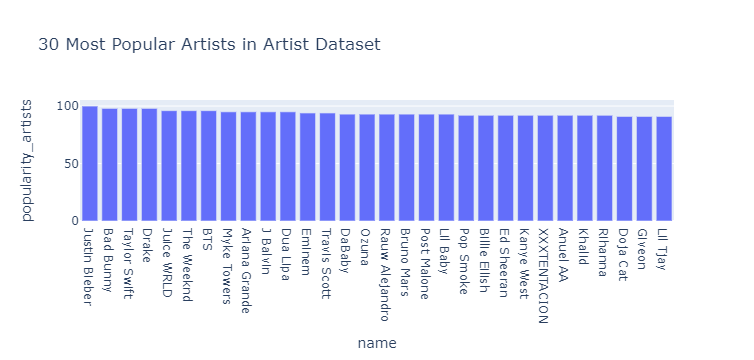

In [23]:
#Now look at genre by popularity in artist dataset
n=30
artistsGenres_byPopularity = artists.nlargest(n,'popularity_artists')
artistsGenres_byPopularity
fig = px.bar(artistsGenres_byPopularity,x='name',y='popularity_artists',title=str(n)+' Most Popular Artists in Artist Dataset')
fig.show()

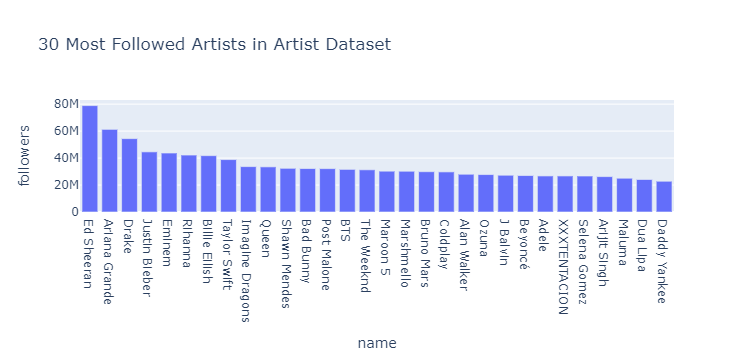

In [24]:
#Now look at genre by followers in artist dataset
n=30
artistsGenres_byFollowers = artists.nlargest(n,'followers')
artistsGenres_byFollowers
fig = px.bar(artistsGenres_byFollowers,x='name',y='followers',title=str(n)+' Most Followed Artists in Artist Dataset')
fig.show()

### Join artists and tracks dataset

##### Merge tracks and artists dataset on tracks.id_artists and artists.id
##### Note: We are only using the first tracks.id_artists in cases where there are multiple artists per song because ultimately we just care about genre from artists dataset and most often collaborating artists are within same genre

In [25]:
#Before merging, make sure that both tracks.id_artists and artists.id are the same format (lists in this case)
#Also, we are only keeping the first id_artists for tracks rows where there are multiple artists

from ast import literal_eval
#artists.loc[artists.genres.notna(),'genres'] = artists.loc[artists.genres.notna(),'genres'].apply(literal_eval)
#for i in ['id_artists','artists']:
for i in ['id_artists']:
    tracks[i] = tracks[i].apply(literal_eval)

In [26]:
# function to pull the ind position of the id
def pull_artist(x,ind):
    try:
        return x[ind]
    except:
        return np.nan

In [27]:
# get first 3 artist ids from column
tracks.loc[:,'artist_id_1'] = tracks.id_artists.apply(lambda x: pull_artist(x,0))
tracks.loc[:,'artist_id_2'] = tracks.id_artists.map(lambda x: pull_artist(x,1))
tracks.loc[:,'artist_id_3'] = tracks.id_artists.map(lambda x: pull_artist(x,2))
tracks[[x for x in tracks.columns if 'artist' in x]].head()

,artists,id_artists,artist_id_1,artist_id_2,artist_id_3
0,['Uli'],[45tIt06XoI0Iio4LBEVpls],45tIt06XoI0Iio4LBEVpls,NaN,NaN
1,['Fernando Pessoa'],[14jtPCOoNZwquk5wd9DxrY],14jtPCOoNZwquk5wd9DxrY,NaN,NaN
2,['Ignacio Corsini'],[5LiOoJbxVSAMkBS2fUm3X2],5LiOoJbxVSAMkBS2fUm3X2,NaN,NaN
3,['Ignacio Corsini'],[5LiOoJbxVSAMkBS2fUm3X2],5LiOoJbxVSAMkBS2fUm3X2,NaN,NaN
4,['Dick Haymes'],[3BiJGZsyX9sJchTqcSA7Su],3BiJGZsyX9sJchTqcSA7Su,NaN,NaN


In [28]:
#Use tracks['artists_id_1'] and artists['id'] to join datasets
artistsTracks = pd.merge(tracks,artists,left_on='artist_id_1',right_on='id',how='left')
artistsTracks.head()

,id_x,name_x,popularity_tracks,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,...,time_signature,release_year,artist_id_1,artist_id_2,artist_id_3,id_y,followers,genres,name_y,popularity_artists
0,35iwgR4jXetI318WEWsa1Q,Carve,6,126903,0,['Uli'],[45tIt06XoI0Iio4LBEVpls],1922-02-22,0.645,0.4450,...,3,1922,45tIt06XoI0Iio4LBEVpls,NaN,NaN,45tIt06XoI0Iio4LBEVpls,91.0,NaN,Uli,4.0
1,021ht4sdgPcrDgSk7JTbKY,Capítulo 2.16 - Banquero Anarquista,0,98200,0,['Fernando Pessoa'],[14jtPCOoNZwquk5wd9DxrY],1922-06-01,0.695,0.2630,...,1,1922,14jtPCOoNZwquk5wd9DxrY,NaN,NaN,14jtPCOoNZwquk5wd9DxrY,3.0,NaN,Fernando Pessoa,0.0
2,07A5yehtSnoedViJAZkNnc,Vivo para Quererte - Remasterizado,0,181640,0,['Ignacio Corsini'],[5LiOoJbxVSAMkBS2fUm3X2],1922-03-21,0.434,0.1770,...,5,1922,5LiOoJbxVSAMkBS2fUm3X2,NaN,NaN,5LiOoJbxVSAMkBS2fUm3X2,3528.0,"['tango', 'vintage tango']",Ignacio Corsini,23.0
3,08FmqUhxtyLTn6pAh6bk45,El Prisionero - Remasterizado,0,176907,0,['Ignacio Corsini'],[5LiOoJbxVSAMkBS2fUm3X2],1922-03-21,0.321,0.0946,...,3,1922,5LiOoJbxVSAMkBS2fUm3X2,NaN,NaN,5LiOoJbxVSAMkBS2fUm3X2,3528.0,"['tango', 'vintage tango']",Ignacio Corsini,23.0
4,08y9GfoqCWfOGsKdwojr5e,Lady of the Evening,0,163080,0,['Dick Haymes'],[3BiJGZsyX9sJchTqcSA7Su],1922-01-01,0.402,0.1580,...,4,1922,3BiJGZsyX9sJchTqcSA7Su,NaN,NaN,3BiJGZsyX9sJchTqcSA7Su,11327.0,"['adult standards', 'big band', 'easy listenin...",Dick Haymes,35.0


In [41]:
#### Group by genre to visualize via clusters
artistsTracksbyGenres = artistsTracks.groupby('genres').mean()
artistsTracksbyGenres.reset_index(inplace=True)

### Cluster Time!

##### Use k-means clustering technique to group ~5000 genres into 10 clusters based on audio features of each track (e.g,. danceability)

In [35]:
#For clustering, use a subset of the merged artists and tracks dataset that contain only numeric audio features of tracks
#artistsTracksCluster = artistsTracks[['duration_ms','danceability', 'energy',
#       'loudness', 'speechiness', 'acousticness',
#       'instrumentalness', 'liveness', 'valence', 'tempo','genres']]

artistsTracksCluster = artistsTracksbyGenres[['duration_ms','danceability', 'energy',
       'loudness', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo','genres']]

artistsTracksCluster.head()

,duration_ms,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,genres
0,146486.666667,0.655833,0.512056,-11.911778,0.124294,0.437556,0.000018,0.238633,0.783222,127.845389,"[""australian children's music"", ""children's fo..."
1,82780.000000,0.743900,0.256318,-15.495975,0.218510,0.598387,0.001513,0.138350,0.717525,124.232825,"[""australian children's music"", ""children's mu..."
2,104695.557692,0.691750,0.690423,-5.993558,0.079062,0.270070,0.002428,0.190658,0.834827,137.238192,"[""australian children's music"", ""children's mu..."
3,144853.000000,0.592000,0.253000,-6.273000,0.060500,0.833000,0.000000,0.095000,0.399000,127.010000,"[""australian children's music"", ""preschool chi..."
4,191460.220000,0.647600,0.286320,-15.824900,0.084282,0.700280,0.002599,0.164582,0.645080,121.717880,"[""australian children's music"", 'australian co..."


In [36]:
#Use kmeans to cluster data into 10 distinct clusters
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])
X = artistsTracksCluster.select_dtypes(np.number)
cluster_pipeline.fit(X)
artistsTracksCluster['cluster'] = cluster_pipeline.predict(X)

C:\Users\MariaZatko\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:792: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).

<ipython-input-36-6bd6558ddb74>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



##### Visualize the genre clusters

In [39]:
from sklearn.manifold import TSNE 

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = artistsTracksCluster['genres']
projection['cluster'] = artistsTracksCluster['cluster']

#from sklearn.decomposition import PCA 

#pca_pipeline = Pipeline([('scaler', StandardScaler()), ('pca', PCA(n_components=2))])
#genre_embedding = pca_pipeline.fit_transform(X)
#projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
#projection['genres'] = artistsTracksCluster['genres']
#projection['cluster'] = artistsTracksCluster['cluster']

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 20111 samples in 0.064s...
[t-SNE] Computed neighbors for 20111 samples in 5.786s...
[t-SNE] Computed conditional probabilities for sample 1000 / 20111
[t-SNE] Computed conditional probabilities for sample 2000 / 20111
[t-SNE] Computed conditional probabilities for sample 3000 / 20111
[t-SNE] Computed conditional probabilities for sample 4000 / 20111
[t-SNE] Computed conditional probabilities for sample 5000 / 20111
[t-SNE] Computed conditional probabilities for sample 6000 / 20111
[t-SNE] Computed conditional probabilities for sample 7000 / 20111
[t-SNE] Computed conditional probabilities for sample 8000 / 20111
[t-SNE] Computed conditional probabilities for sample 9000 / 20111
[t-SNE] Computed conditional probabilities for sample 10000 / 20111
[t-SNE] Computed conditional probabilities for sample 11000 / 20111
[t-SNE] Computed conditional probabilities for sample 12000 / 20111
[t-SNE] Computed conditional probabilities for sam

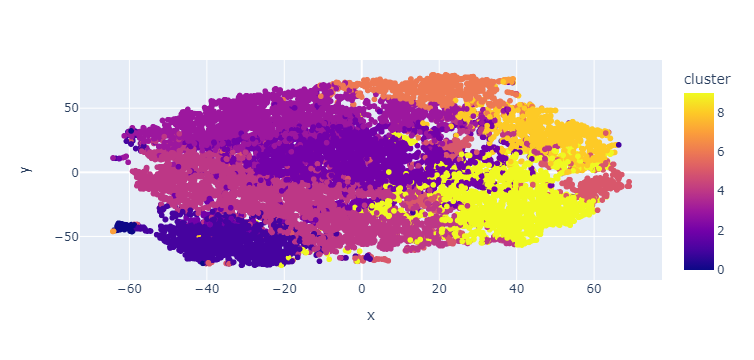

In [40]:
#Plot the reduced clusters
fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()